In [18]:
%autosave 0

Autosave disabled


In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import networkx as nx
from scipy.spatial import cKDTree as KDTree
from tqdm import tqdm

## Load Data

In [3]:
# Load spot coordinates
barcodes_df = pd.read_csv("../data/MERFISH_Moffitt_et_al/merfish_barcodes_example.csv")

# Remove unsassigned barcodes in Moffit et al.
remove_genes = ['Blank-1', 'Blank-2', 'Blank-3', 'Blank-4', 'Blank-5']
barcodes_df = barcodes_df[~barcodes_df.Gene_name.isin(remove_genes)]


barcodes_df.reset_index(drop=True, inplace=True)
tagList_df = pd.DataFrame(barcodes_df.Gene_name.unique(), columns=['Gene'])
barcodes_df.shape

(3728169, 13)

In [21]:
# Auxiliary function to build spatial gene expression graph
def buildGraph(barcodes_df, d_th):
    G = nx.Graph()
    node_removed = []
    barcodes_df.reset_index(drop=True, inplace=True)

    kdT = KDTree(np.array([barcodes_df.Centroid_X.values,barcodes_df.Centroid_Y.values, barcodes_df.Centroid_Z.values]).T)
    res = kdT.query_pairs(d_th)
    res = [(x[0],x[1]) for x in list(res)]

    # Add nodes
    G.add_nodes_from((barcodes_df.index.values), test=False, val=False, label=0)
    # Add edges
    G.add_edges_from(res)

    # Remove connected components with less than N nodes, representing spurious gene expression
    N=3
    for component in tqdm(list(nx.connected_components(G))):
        if len(component)<N:
            for node in component:
                node_removed.append(node)
                G.remove_node(node)

    barcodes_df = barcodes_df[~barcodes_df.index.isin(node_removed)]
    barcodes_df.reset_index(drop=True, inplace=True)
    
    
    return G, barcodes_df

In [22]:
# Auxiliary function to compute maximum nearest neighbor distance d_th
def plotNeighbor(barcodes_df):
    barcodes_df.reset_index(drop=True, inplace=True)
    
    # Find mean distance to nearest neighbor
    kdT = KDTree(np.array([barcodes_df.Centroid_X.values,barcodes_df.Centroid_Y.values, barcodes_df.Centroid_Z.values]).T)
    d,i = kdT.query(np.array([barcodes_df.Centroid_X.values,barcodes_df.Centroid_Y.values, barcodes_df.Centroid_Z.values]).T,k=2)
    plt.hist(d[:,1],bins=200);
    plt.axvline(x=np.percentile(d[:,1],97),c='r')
    print(np.percentile(d[:,1],97))
    d_th = np.percentile(d[:,1],97)
    return d_th

#### Estimate maximum nearest neighbor distance for connecting spots in spatial gene expression graph on the first half of the sample as in training (< 2800 um)

1.715665725017621


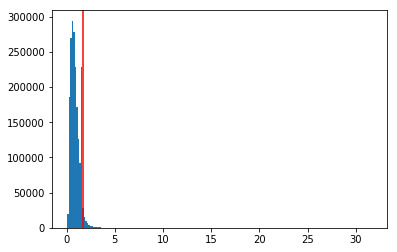

In [23]:
d_th = plotNeighbor(barcodes_df[(barcodes_df.Centroid_X<-2800)])

#### Generate spatial gene expression graph

In [24]:
G, barcodes_df = buildGraph(barcodes_df, d_th)

100%|██████████| 237359/237359 [00:00<00:00, 546832.31it/s]


In [25]:
# Number of nodes in the graph
G.number_of_nodes()

3518190

In [26]:
barcodes_df.shape

(3518190, 13)

## Load Embedding

In [27]:
X = np.load('../results/MERFISH_Moffitt_et_al/embedding_MERFISH.npy')
X = np.ascontiguousarray(X, dtype=np.float32)

In [28]:
X.shape

(3518190, 50)

## Visualization of node embeddings

In [13]:
import umap

reducer = umap.UMAP(
    n_neighbors=10,
    n_components=3,
    n_epochs=500,
    init='spectral',
    min_dist=0.5,
    spread=1,
    random_state=42,
    verbose=True
)

embedding = reducer.fit_transform(X)

UMAP(a=None, angular_rp_forest=False, b=None, init='spectral',
     learning_rate=1.0, local_connectivity=1.0, metric='euclidean',
     metric_kwds=None, min_dist=0.5, n_components=3, n_epochs=500,
     n_neighbors=10, negative_sample_rate=5, random_state=42,
     repulsion_strength=1.0, set_op_mix_ratio=1.0, spread=1,
     target_metric='categorical', target_metric_kwds=None,
     target_n_neighbors=-1, target_weight=0.5, transform_queue_size=4.0,
     transform_seed=42, verbose=True)
Construct fuzzy simplicial set
Sun Dec 22 17:24:17 2019 Finding Nearest Neighbors
Sun Dec 22 17:24:17 2019 Building RP forest with 99 trees


/home/gabpa510/miniconda3/envs/cuUMAP/lib/python3.7/site-packages/numba/typed_passes.py:271: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "miniconda3/envs/cuUMAP/lib/python3.7/site-packages/umap/rp_tree.py", line 135:
@numba.njit(fastmath=True, nogil=True, parallel=True)
def euclidean_random_projection_split(data, indices, rng_state):
^

  state.func_ir.loc))


Sun Dec 22 17:39:14 2019 NN descent for 22 iterations


/home/gabpa510/miniconda3/envs/cuUMAP/lib/python3.7/site-packages/umap/nndescent.py:92: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "miniconda3/envs/cuUMAP/lib/python3.7/site-packages/umap/utils.py", line 409:
@numba.njit(parallel=True)
def build_candidates(current_graph, n_vertices, n_neighbors, max_candidates, rng_state):
^

  current_graph, n_vertices, n_neighbors, max_candidates, rng_state
/home/gabpa510/miniconda3/envs/cuUMAP/lib/python3.7/site-packages/numba/typed_passes.py:271: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for 

	 0  /  22
	 1  /  22
Sun Dec 22 17:44:38 2019 Finished Nearest Neighbor Search
Sun Dec 22 17:45:54 2019 Construct embedding


/home/gabpa510/miniconda3/envs/cuUMAP/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 41 separate connected components using meta-embedding (experimental)
  n_components


	completed  0  /  500 epochs
	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs
Sun Dec 22 21:57:17 2019 Finished embedding


In [14]:
# Save UMAP projection
np.save('../results/MERFISH_Moffitt_et_al/MERFISH_umap.npy',embedding)

In [29]:
# Load UMAP projection
embedding = np.load('../results/MERFISH_Moffitt_et_al/MERFISH_umap.npy')
embedding.shape

(3518190, 3)

In [30]:
Y_umap = embedding
Y_umap -= np.min(Y_umap, axis=0)
Y_umap /= np.max(Y_umap, axis=0)
Y_umap.shape

(3518190, 3)

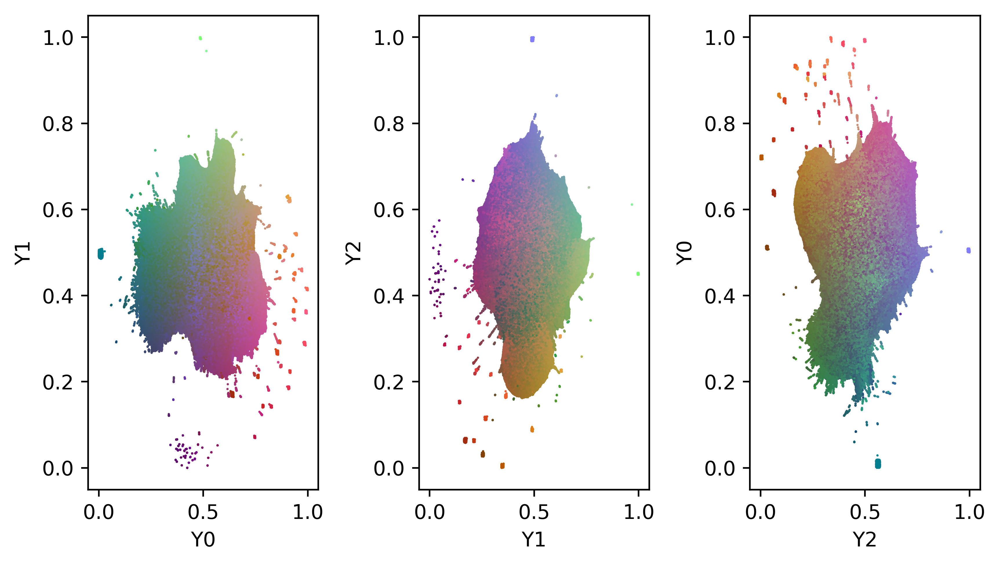

In [15]:
import matplotlib.pyplot as plt

fig=plt.figure(figsize=(7,4),dpi=500)
cycled = [0,1,2,0]
for i in range(3):
    plt.subplot(1,3,i+1)
    plt.scatter(Y_umap[:,cycled[i]], Y_umap[:,cycled[i+1]], c=Y_umap,  s=5, marker='.', linewidths=0, edgecolors=None)
    plt.xlabel("Y"+str(cycled[i]))
    plt.ylabel("Y"+str(cycled[i+1]))
plt.tight_layout()
# plt.savefig('../figures/SupFig6b.png', dpi=500, bbox_inches='tight', pad_inches=0.0)

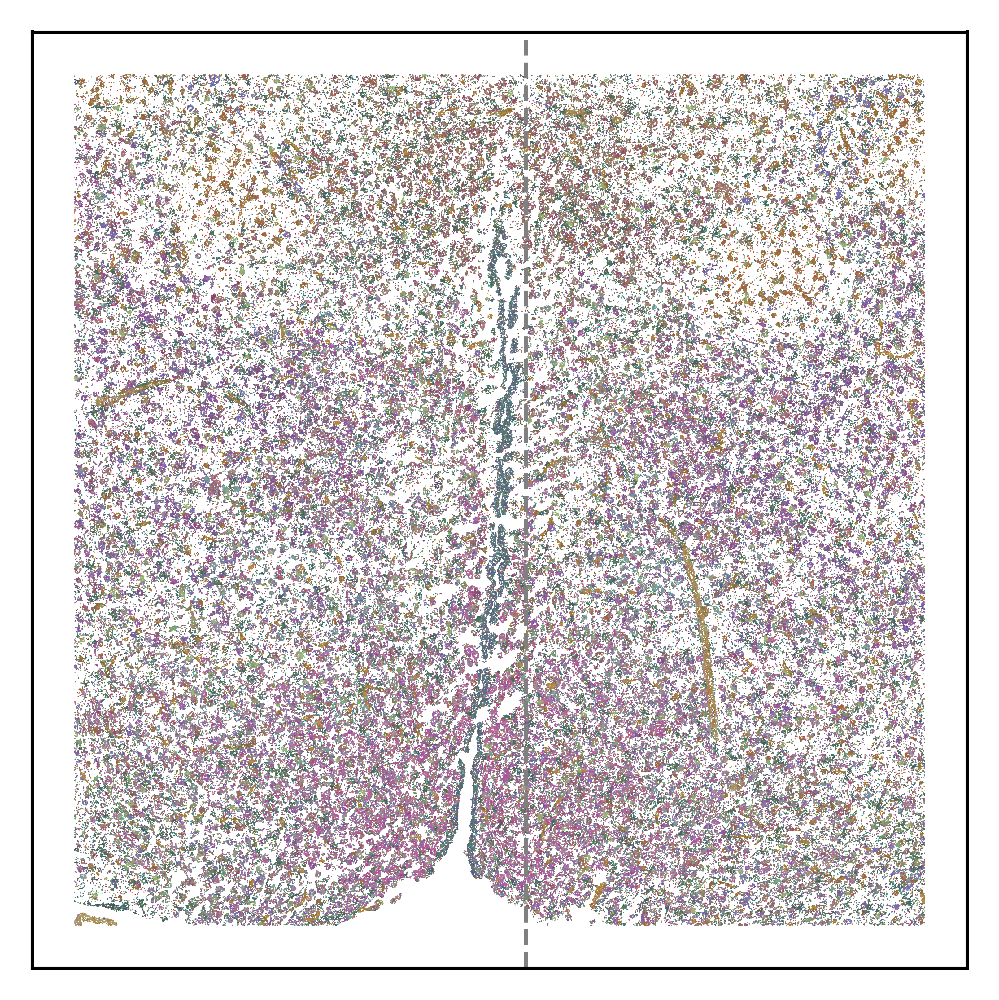

In [30]:
fig=plt.figure(figsize=(4,4),dpi=1000)
plt.scatter(barcodes_df[barcodes_df.Centroid_Z==4.5].Centroid_X, barcodes_df[barcodes_df.Centroid_Z==4.5].Centroid_Y, c=Y_umap[barcodes_df.Centroid_Z==4.5], s=0.3, marker='.',linewidths=0, edgecolors=None);
plt.axvline(x=-2800,linestyle = '--',linewidth=1, color='gray')
plt.xticks([])
plt.yticks([]);
plt.axis('scaled');
# plt.savefig('../figures/Fig4a.png', dpi=1000, bbox_inches='tight', pad_inches=0.0)

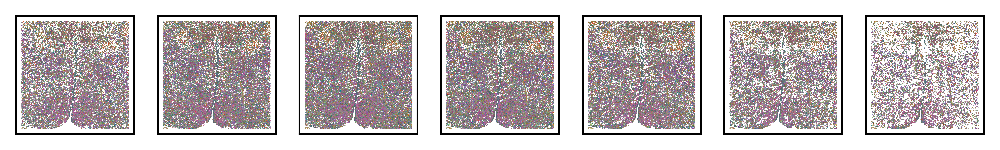

In [14]:
# Plot all z-levels
fig=plt.figure(figsize=(8,2),dpi=1000)
for i,z in enumerate(barcodes_df.Centroid_Z.unique()):
    plt.subplot(1,7, i+1)
    plt.scatter(barcodes_df[barcodes_df.Centroid_Z==z].Centroid_X, barcodes_df[barcodes_df.Centroid_Z==z].Centroid_Y, c=Y_umap[barcodes_df.Centroid_Z==z], s=0.1, marker='.',linewidths=0, edgecolors=None);
    plt.xticks([])
    plt.yticks([]);
    plt.axis('scaled');
# plt.savefig('../figures/Fig4d.png', dpi=1000, bbox_inches='tight', pad_inches=0.0)

In [31]:
# Annotate rgb color-space spot locations
from matplotlib.colors import to_hex
from tqdm.notebook import tqdm

barcodes_df['colorspace'] = [to_hex(Y_umap[x,:], keep_alpha=False) for x in tqdm(range(Y_umap.shape[0]))]

## Identification of distinct gene constellations and spatial domains

#### Clustering of the embedding space with Scanpy [1] implementation of Leiden clustering  algortihm

[1] ***Wolf, F. Alexander, Philipp Angerer, and Fabian J. Theis. "SCANPY: large-scale single-cell gene expression data analysis." Genome biology 19.1 (2018): 15.***

In [32]:
import scanpy as sc

sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_versions()
results_file = '../results/MERFISH_Moffitt_et_al/MERFISH.h5'  # the file that will store the analysis results

scanpy==1.4.4.post1 anndata==0.6.22.post1 umap==0.3.10 numpy==1.17.3 scipy==1.3.2 pandas==0.24.2 scikit-learn==0.21.3 statsmodels==0.10.1 python-igraph==0.7.1 louvain==0.6.1


In [12]:
adata = sc.AnnData(X=X)

In [13]:
# Compute the neighborhood graph
sc.pp.neighbors(adata, n_neighbors=15)

computing neighbors
    using data matrix X directly


/home/gabpa510/miniconda3/envs/cuUMAP/lib/python3.7/site-packages/numba/typed_passes.py:271: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "miniconda3/envs/cuUMAP/lib/python3.7/site-packages/umap/rp_tree.py", line 135:
@numba.njit(fastmath=True, nogil=True, parallel=True)
def euclidean_random_projection_split(data, indices, rng_state):
^

  state.func_ir.loc))
/home/gabpa510/miniconda3/envs/cuUMAP/lib/python3.7/site-packages/umap/nndescent.py:92: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "miniconda3/envs/cuUMAP/lib/p

    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:24:46)


In [14]:
# Run Leiden clustering algorithm
sc.tl.leiden(adata)

running Leiden clustering
    finished: found 198 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (21:08:56)


In [15]:
# save clustering data
adata.write(results_file)

In [33]:
# Load clustering data
adata = sc.read(results_file)

In [34]:
# Extract leiden clusters
col_cluster = adata.obs['leiden'].values.astype(int)
col = np.unique(col_cluster)

In [35]:
# Add leiden clusters to spots dataframe
barcodes_df['cluster'] = adata.obs['leiden'].values
go_clusters = np.unique(adata.obs['leiden'].values)
barcodes_df.head()

,Gene_name,Cell_name,Animal_ID,Bregma,Animal_sex,Behavior,Centroid_X,Centroid_Y,Centroid_Z,Total_brightness,Area,Error_bit,Error_direction,colorspace,cluster
0,Krt90,NaN,1,-0.24,Female,Naive,-3683.219,-3742.586,0.0,283.25800,7,0,0,#6c885c,10
1,Krt90,NaN,1,-0.24,Female,Naive,-3680.675,-3909.088,0.0,36.64278,4,0,0,#b28e3e,15
2,Krt90,96121573-136d-4fbe-8b2f-62f29a4703ed,1,-0.24,Female,Naive,-3606.048,-3739.105,0.0,30.92323,4,0,0,#6eb491,5
3,Krt90,NaN,1,-0.24,Female,Naive,-3605.668,-3807.524,0.0,28.73519,4,0,0,#5b7f51,10
4,Krt90,NaN,1,-0.24,Female,Naive,-3594.764,-3747.853,0.0,425.50650,6,0,0,#7a4e91,8


## Compare with Moffitt et al. cell-type map
[2] ***Moffitt, Jeffrey R., et al. "Molecular, spatial, and functional single-cell profiling of the hypothalamic preoptic region." Science 362.6416 (2018): eaau5324.***

In [36]:
# Auxiliary function for plotting heatmap
def heat_map(df, labels, sort=None, cluster_colors=None, 
             cluster_number = False, save=False, name='', fontsz=8, figsz=(10,10)):
    """
    Plot heat_map of a dataframe.
    Input:
    `df`(pandas dataframe): Dataframe to plot. Cells as columns, genes as rows.
    `labels`(list/array): list of labels of the cells in the same order as the 
        df columns.
    `sort`(list): List of sorted cluster numbers. If None it will plot them in
        assending order
    `cluster_colors`(dict): Dictionary matching cluster numbers with colors
        in the hex fomat. Like '#ff0000' for red
    `cluster_number`(bool): Show cluster numbers in the top color bar. Usefull
        when manually sorting the clusters.
    `save`(bool): option to save the figure as png with 300dpi.
    `name`(str): Name to use when saving
    
    """
    #Find the name of the input df, for logging
    df_input_name =[x for x in globals() if globals()[x] is df][0]
    print('df used for plot: {}'.format(df_input_name))
    
    if sort == None:
        optimal_order = np.unique(labels)    
    else:
        optimal_order = sort
    print('Order of clusters: {}'.format(optimal_order))
    
    cl, lc = gen_labels(df, np.array(labels))[:2]
    
    #Sort the cells according to the optimal cluster order
    optimal_sort_cells = sum([lc[i] for i in optimal_order], [])
    
    #Create a list of optimal sorted cell labels
    optimal_sort_labels = [cl[i] for i in optimal_sort_cells]
    
    fig, axHM = plt.subplots(figsize=figsz)
    
    df_full = df.copy()
    z = df_full.values
    z = pd.DataFrame(z, index=df_full.index, columns=df_full.columns)
    z = z.loc[:,optimal_sort_cells]
    
    
    im = axHM.pcolormesh(z.values, cmap='viridis')
    
    plt.yticks(np.arange(0.5, len(df.index), 1), z.index, fontsize=fontsz)
    plt.gca().invert_yaxis()
    plt.xlim(xmax=len(labels))
    plt.xticks(np.arange(0.5,df.shape[1],step=1), labels=z.columns, rotation='vertical', fontsize=fontsz)

    divider = make_axes_locatable(axHM)
    axLabel = divider.append_axes("top", .3, pad=0, sharex=axHM)
    
    counter = Counter(labels)
    pos=0
    if cluster_colors == None:
        optimal_sort_labels = np.array(optimal_sort_labels)
        axLabel.pcolor(optimal_sort_labels[None,:]/max(optimal_sort_labels), cmap='nipy_spectral')
        if cluster_number==True:
            for l in optimal_order:
                axLabel.text(pos + (counter[l]/2), 1.2, l, fontsize=fontsz,
                         horizontalalignment='center', verticalalignment='center')
                pos += Counter(labels)[l]
        
    else:
        for l in optimal_order:
            #Use Bottom instead of y for older versions of matplotlib
            axLabel.barh(y = 0, left = pos, width = counter[l], color=cluster_colors[l],
                        linewidth=0.5, edgecolor=cluster_colors[l])
            if cluster_number==True:
                axLabel.text(pos + (counter[l]/2), 0, l, fontsize=fontsz,
                         horizontalalignment='center', verticalalignment='center')
            pos += Counter(labels)[l]
    
    axLabel.set_xlim(xmax=len(labels))
    axLabel.axis('off')
    
    cax = fig.add_axes([.91, 0.13, 0.01, 0.22])
    colorbar = fig.colorbar(im, cax=cax, ticks=[0,1])
    colorbar.set_ticklabels(['0', 'max'])
    
#     if save == True:
#         plt.savefig('../figures/{}.svg'.format(name), dpi=500)
    

In [37]:
# Auxiliary functions for merging clusters
def post_merge(df, labels, post_merge_cutoff, linkage_method='single', 
               linkage_metric='correlation', fcluster_criterion='distance'):
    """
    Merge clusters based on likage and a cutoff. The mean expression levels of 
    the clusters are linked and them merged based on the cutoff provided.
    Input:
    `df`(Pandas dataframe): df with expression matrix. row-genes, col-cells.
    `labels`(list/array): Labels of the cells.
    `post_merge_cutoff`(float): Merge clusters that have a distance from each 
        other below the cutoff.
    `linkage_method`(string): Scipy linkage methods. Default = 'single'
    `linkage_metric`(string): Scipy lingae metric. Default = 'correlation'
    `fcluster_criterion`(string): Scipy fcluster criterion. Default = 'distance'

    Returns:
    `new_labels`(list): List of new cell labels after merging. 
    Additionally it plots the dendrogram showing which clusters are merged.

    """
    Z = scipy.cluster.hierarchy.linkage(df.T, method=linkage_method, metric=linkage_metric)
    merged_labels_short = scipy.cluster.hierarchy.fcluster(Z, post_merge_cutoff, criterion=fcluster_criterion)

    #Update labels  
    label_conversion = dict(zip(df.columns, merged_labels_short))
    label_conversion_r = dict(zip(merged_labels_short, df.columns))
    new_labels = [label_conversion[i] for i in labels] 

    #Plot the dendrogram to visualize the merging
    fig, ax = plt.subplots(figsize=(20,10))
    scipy.cluster.hierarchy.dendrogram(Z, labels=df.columns ,color_threshold=post_merge_cutoff)
    ax.hlines(post_merge_cutoff, 0, ax.get_xlim()[1])
    ax.set_title('Merged clusters')
    ax.set_ylabel(linkage_metric, fontsize=20)
    ax.set_xlabel('pre-merge cluster labels', fontsize=20)
    ax.tick_params(labelsize=10)

    return new_labels

def gen_labels(df, model):
    """
    Generate cell labels from model.
    Input:
    `df`: Panda's dataframe that has been used for the clustering. (used to 
    get the names of colums and rows)
    `model`(obj OR array): Clustering object. OR numpy array with cell labels.
    Returns (in this order):
    `cell_labels` = Dictionary coupling cellID with cluster label
    `label_cells` = Dictionary coupling cluster labels with cellID
    `cellID` = List of cellID in same order as labels
    `labels` = List of cluster labels in same order as cells
    `labels_a` = Same as "labels" but in numpy array
    
    """
    if str(type(model)).startswith("<class 'sklearn.cluster"):
        cell_labels = dict(zip(df.columns, model.labels_))
        label_cells = {}
        for l in np.unique(model.labels_):
            label_cells[l] = []
        for i, label in enumerate(model.labels_):
            label_cells[label].append(df.columns[i])
        cellID = list(df.columns)
        labels = list(model.labels_)
        labels_a = model.labels_
    elif type(model) == np.ndarray:
        cell_labels = dict(zip(df.columns, model))
        label_cells = {}
        for l in np.unique(model):
            label_cells[l] = []
        for i, label in enumerate(model):
            label_cells[label].append(df.columns[i])
        cellID = list(df.columns)
        labels = list(model)
        labels_a = model
    else:
        print('Error wrong input type')
    
    return cell_labels, label_cells, cellID, labels, labels_a

In [38]:
# Create cluster gene expression matrix
hm = barcodes_df.groupby(['Gene_name','cluster']).size().unstack(fill_value=0)
hm.shape

(135, 198)

#### Merge cluster based on correlation distance

In [39]:
# Z-score normalization
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
hm = pd.DataFrame(scaler.fit_transform(hm.values), columns=hm.columns, index=hm.index)
hm.head()

cluster,0,1,2,3,4,5,6,7,8,9,...,188,189,190,191,192,193,194,195,196,197
Gene_name,,,,,,,,,,,,,,,,,,,,,
Ace2,-0.317695,-0.384633,-0.372359,-0.361477,-0.192612,-0.314063,-0.313318,-0.208970,-0.377705,-0.251021,...,-0.086387,-0.086387,-0.086387,-0.086387,-0.086387,-0.099534,-0.086387,-0.086387,-0.086387,-0.086387
Adora2a,-0.304283,-0.372160,-0.372359,-0.345114,-0.183643,-0.316755,-0.308060,-0.203230,-0.378065,-0.226497,...,-0.086387,-0.086387,-0.086387,-0.086387,-0.086387,-0.099534,-0.086387,-0.086387,-0.086387,-0.086387
Aldh1l1,-0.304723,-0.304016,-0.363323,-0.314059,-0.182458,-0.304193,-0.297837,0.815191,-0.380590,-0.203489,...,-0.086387,-0.086387,-0.086387,-0.086387,-0.086387,-0.099534,-0.086387,-0.086387,-0.086387,11.575837
Amigo2,-0.227333,-0.235262,-0.240376,8.662352,-0.099025,0.026601,-0.185090,-0.216690,-0.367969,-0.254308,...,-0.086387,-0.086387,-0.086387,-0.086387,-0.086387,-0.099534,-0.086387,-0.086387,-0.086387,-0.086387
Ano3,-0.251517,-0.275723,-0.317177,-0.300034,-0.160458,-0.227925,-0.261034,-0.176507,-0.225895,-0.244448,...,-0.086387,-0.086387,-0.086387,-0.086387,-0.086387,-0.099534,-0.086387,-0.086387,-0.086387,-0.086387


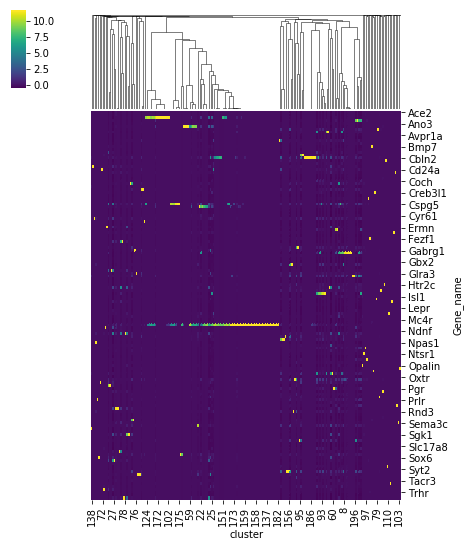

In [40]:
# Plot hierarchical clustering based on correlation
import seaborn as sns
g = sns.clustermap(hm, row_cluster=False, metric='correlation', method='average', cmap='viridis',figsize=(7,9))
# g.savefig("../figures/SupFig7.svg", dpi=500, bbox_inches='tight', pad_inches=0.0)

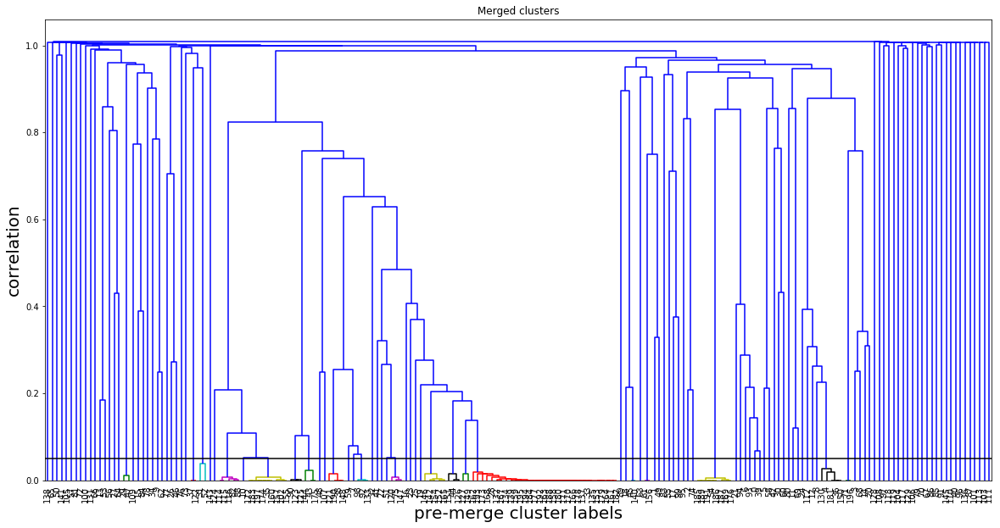

In [41]:
# Merge high correlated clusters
import scipy
hm_merge = post_merge(hm, hm.columns, 0.05, linkage_metric='correlation', linkage_method='average')

In [42]:
# Macroclusters
np.unique(hm_merge)

array([  1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,  13,
        14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,  26,
        27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,  39,
        40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,  52,
        53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,  65,
        66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,  78,
        79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,  91,
        92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103, 104,
       105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117,
       118, 119, 120, 121], dtype=int32)

In [43]:
# Create cluster gene expression matrix
hm = barcodes_df.groupby(['Gene_name','cluster']).size().unstack(fill_value=0)
hm.head()

cluster,0,1,2,3,4,5,6,7,8,9,...,188,189,190,191,192,193,194,195,196,197
Gene_name,,,,,,,,,,,,,,,,,,,,,
Ace2,67,80,106,108,52,113,48,54,57,83,...,0,0,0,0,0,0,0,0,0,0
Adora2a,128,121,106,157,105,104,66,83,56,180,...,0,0,0,0,0,0,0,0,0,0
Aldh1l1,126,345,134,250,112,146,101,5228,49,271,...,0,0,0,0,0,0,0,0,0,5
Amigo2,478,571,515,27131,605,1252,487,15,84,70,...,0,0,0,0,0,0,0,0,0,0
Ano3,368,438,277,292,242,401,227,218,478,109,...,0,0,0,0,0,0,0,0,0,0


In [44]:
# Compute new cluster gene expression matrix based on macro clusters from merging results
hm_macro = pd.DataFrame(np.zeros((hm.shape[0], np.unique(hm_merge).shape[0])), index=hm.index, columns=np.unique(hm_merge))

for d in np.unique(hm_merge):
    # merge clusters by averaging the expression
    hm_macro.loc[:,d] = hm.iloc[:,np.where(np.array(hm_merge)==d)[0]].sum(axis=1)

In [45]:
# Z-score normalization
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
hm_macro = pd.DataFrame(scaler.fit_transform(hm_macro.values), columns=hm_macro.columns, index=hm_macro.index)
hm_macro.head()

,1,2,3,4,5,6,7,8,9,10,...,112,113,114,115,116,117,118,119,120,121
Gene_name,,,,,,,,,,,,,,,,,,,,,
Ace2,-0.086387,-0.09709,-0.297126,-0.086387,-0.370600,-0.086387,-0.086387,0.064032,-0.245106,-0.086387,...,-0.086387,-0.086387,-0.086387,-0.086387,-0.086387,-0.086387,-0.086387,-0.089128,-0.091478,-0.095359
Adora2a,-0.086387,-0.09709,-0.279142,-0.086387,-0.321558,-0.086387,-0.086387,0.048267,-0.226682,-0.086387,...,-0.086387,-0.086387,-0.086387,-0.086387,-0.086387,-0.086387,-0.086387,-0.089128,-0.091478,-0.095359
Aldh1l1,-0.086387,-0.09709,-0.225192,-0.086387,-0.375504,-0.086387,-0.086387,-0.097791,-0.250801,-0.086387,...,-0.086387,-0.086387,-0.086387,-0.086387,-0.086387,-0.086387,-0.086387,-0.089128,-0.091478,-0.095359
Amigo2,-0.086387,-0.09709,-0.220156,-0.086387,-0.120484,-0.086387,-0.086387,-0.159924,-0.256496,-0.086387,...,-0.086387,-0.086387,-0.086387,-0.086387,-0.086387,-0.086387,-0.086387,-0.089128,-0.091478,-0.095359
Ano3,-0.086387,-0.09709,-0.273747,-0.086387,-0.385313,-0.086387,-0.086387,-0.152041,-0.263531,-0.086387,...,-0.086387,-0.086387,-0.086387,-0.086387,-0.086387,-0.086387,-0.086387,-0.089128,-0.091478,-0.095359


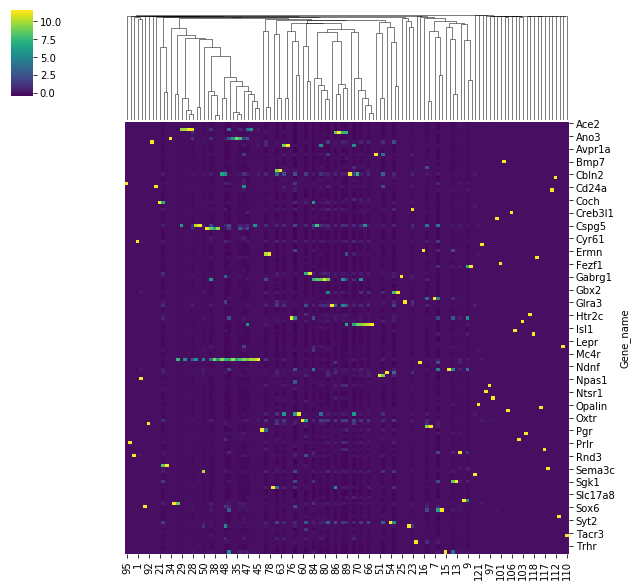

In [46]:
# Plot hierarchical clustering based on correlation
import seaborn as sns
sns.clustermap(hm_macro, row_cluster=False, metric='correlation', method='average', cmap='viridis')

In [47]:
# Annotate spots with macro cluster labels
hm_merge = np.array(hm_merge)
for macro_go in np.unique(hm_merge):
    barcodes_df.loc[barcodes_df.cluster.astype(int).isin(np.where(np.isin(hm_merge,[macro_go]))[0]),'macro_cluster'] = macro_go

In [83]:
# Load MERFISH cell-type data and assign cell type to barcodes
cell_df = pd.read_csv("../data/MERFISH_Moffitt_et_al/Moffitt_and_Bambah-Mukku_et_al_merfish_all_cells.csv")
name2class = dict(zip(cell_df.Cell_ID.values,cell_df.Cell_class.values))
name2type = dict(zip(cell_df.Cell_ID.values,cell_df.Neuron_cluster_ID.values))

In [33]:
## Annotate spots with cell-type labels from MERFISH
# Remove spots without cell-type annotation
barcodes_df = barcodes_df[~barcodes_df.Cell_name.isna()]
# Add cell types
barcodes_df['cell_class'] = barcodes_df.Cell_name.map(name2class)
# Add neuronal types
barcodes_df['cell_type'] = barcodes_df.Cell_name.map(name2type)
# Cell type = cell class if nan
def copyCellClass(ctype, cclass):
    if pd.isna(ctype):
        ctype = cclass
        
    return ctype

barcodes_df['cell_cluster'] = barcodes_df.apply(lambda x: copyCellClass(x.cell_type, x.cell_class),axis=1)

In [16]:
# Create labels-colors dictionares for plotting

scCT=['Endothelial 1', 'OD Immature 1', 'OD Immature 2', 'Astrocyte',
       'Ambiguous', 'E-18', 'I-7', 'E-3', 'I-13', 'Microglia', 'E-1',
       'E-19', 'Pericytes', 'I-1', 'OD Mature 2', 'I-30', 'I-31', 'E-15',
       'E-4', 'I-19', 'E-2', 'E-7', 'I-20', 'I-18', 'I-23', 'OD Mature 1',
       'I-2', 'Endothelial 2', 'I-26', 'I-29', 'E-13', 'I-25', 'I-9',
       'I-11', 'Endothelial 3', 'E-16', 'E-14', 'E-28', 'I-3', 'E-6',
       'I-16', 'I-15', 'I-12', 'Ependymal', 'I-22', 'I-14', 'I-4', 'E-11',
       'E-23', 'I-10', 'I-8', 'E-25', 'E-21', 'E-30', 'I-6', 'I-21',
       'E-24', 'E-12', 'I-24', 'E-20', 'E-9', 'OD Mature 4', 'E-17',
       'I-37', 'OD Mature 3', 'E-31', 'E-22', 'E-8', 'I-27', 'I-33',
       'I-34', 'E-26', 'I-5', 'E-29', 'E-10', 'E-5', 'H-1']

superclassCT = ['Endothelial', 'Immature OD', 'Immature OD', 'Astrocyte',
                'Ambiguous', 'Excitatory', 'Inhibitory', 'Excitatory', 'Inhibitory', 'Microglia', 'Excitatory',
                'Excitatory', 'Mural', 'Inhibitory', 'Mature OD', 'Inhibitory', 'Inhibitory', 'Excitatory',
                'Excitatory', 'Inhibitory', 'Excitatory', 'Excitatory', 'Inhibitory', 'Inhibitory', 'Inhibitory', 'Mature OD',
                'Inhibitory', 'Endothelial', 'Inhibitory', 'Inhibitory', 'Excitatory', 'Inhibitory', 'Inhibitory',
                'Inhibitory', 'Endothelial', 'Excitatory', 'Excitatory', 'Excitatory', 'Inhibitory', 'Excitatory',
                'Inhibitory', 'Inhibitory', 'Inhibitory', 'Ependymal', 'Inhibitory', 'Inhibitory', 'Inhibitory', 'Excitatory',
                'Excitatory', 'Inhibitory', 'Inhibitory', 'Excitatory', 'Excitatory', 'Excitatory', 'Inhibitory', 'Inhibitory',
                'Excitatory', 'Excitatory', 'Inhibitory', 'Excitatory', 'Excitatory', 'Mature OD', 'Excitatory',
                'Inhibitory', 'Mature OD', 'Excitatory', 'Excitatory', 'Excitatory', 'Inhibitory', 'Inhibitory',
                'Inhibitory', 'Excitatory', 'Inhibitory', 'Excitatory', 'Excitatory', 'Excitatory', 'Inhibitory']

cluster_sort = [6,4,7,5,1,8,3,2,9,0]
subcluster_sort_dict = {'I-1':0,
                   'I-2':1,
                   'I-3':2,
                   'I-4':3,
                   'I-5':4,
                   'I-6':5,
                   'I-7':6,
                   'I-8':7,
                   'I-9':8,
                   'I-10':9,
                   'I-11':10,
                   'I-12':11,
                   'I-13':12,
                   'I-14':13,
                   'I-15':14,
                   'I-16':15,
                   'I-18':16,
                   'I-19':17,
                   'I-20':18,
                   'I-21':19,
                   'I-22':20,
                   'I-23':21,
                   'I-24':22,
                   'I-25':23,
                   'I-26':24,
                   'I-27':25,
                   'I-29':26,
                   'I-30':27,
                   'I-31':28,
                   'I-33':29,
                   'I-34':30,
                   'I-37':31,
                   'H-1':32,
                   'E-1':33,
                   'E-2':34,
                   'E-3':35,
                   'E-4':36,
                   'E-5':37,
                   'E-6':38,
                   'E-7':39,
                   'E-8':40,
                   'E-9':41,
                   'E-10':42,
                   'E-11':43,
                   'E-12':44,
                   'E-13':45,
                   'E-14':46,
                   'E-15':47,
                   'E-16':48,
                   'E-17':49,
                   'E-18':50,
                   'E-19':51,
                   'E-20':52,
                   'E-21':53,
                   'E-22':54,
                   'E-23':55,
                   'E-24':56,
                   'E-25':57,
                   'E-26':58,
                   'E-28':59,
                   'E-29':60,
                   'E-30':61,
                   'E-31':62,
                   'OD Mature 1':63,
                   'OD Mature 2':64,
                   'OD Mature 3':65,
                   'OD Mature 4':66,
                   'OD Immature 1':67,
                   'OD Immature 2':68,
                   'Astrocyte':69,
                   'Microglia':70,
                   'Ependymal':71,
                   'Endothelial 1':72,
                   'Endothelial 2':73,
                   'Endothelial 3':74,
                   'Pericytes':75,
                   'Ambiguous':76
                  }

ctname_dict = dict(zip(scCT, superclassCT))

d = dict(zip(np.unique(superclassCT), np.arange(np.unique(superclassCT).shape[0])))

color_clusters = {
    6: '#ef2420',
    4: '#59a3e4',
    7: '#79c535',
    5: '#d7439b',
    1: '#94544c',
    8: '#e51c98',
    3: '#5355b8',
    2: '#ffd109',
    9: '#fb982b',
    0: '#000000'
}

In [35]:
# Remove spots without cell-type annotation
barcodes_df = barcodes_df[~barcodes_df.cell_cluster.isna()]
barcodes_df.shape

(1866886, 18)

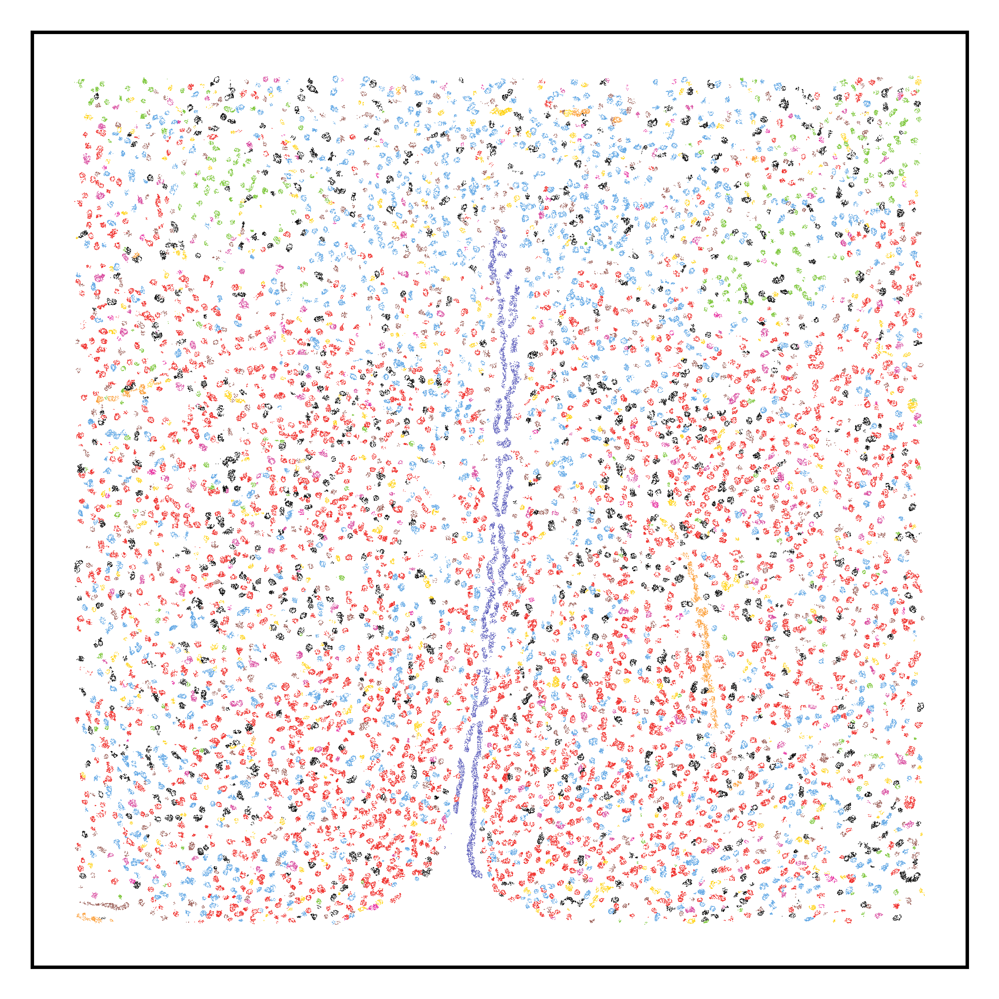

In [43]:
# Plot Cell-type map from pciSeq
fig=plt.figure(figsize=(4,4),dpi=1000)
plt.scatter(barcodes_df[barcodes_df.Centroid_Z==4.5].Centroid_X, barcodes_df[barcodes_df.Centroid_Z==4.5].Centroid_Y, c=[color_clusters[d[ctname_dict[ct]]] for ct in barcodes_df[barcodes_df.Centroid_Z==4.5].cell_cluster.values],  s=0.1,marker='.',linewidths=0, edgecolors=None)
plt.xticks([])
plt.yticks([])
plt.axis('scaled');
# plt.savefig('../figures/Fig4b.png', dpi=1000, bbox_inches='tight', pad_inches=0.0)

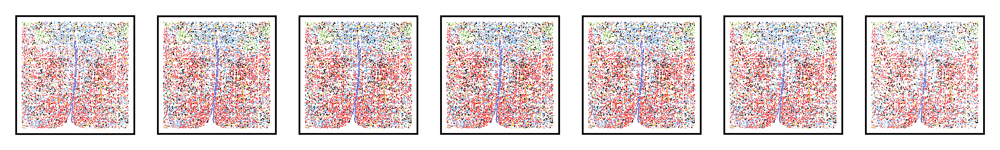

In [37]:
# Plot all z-levels
fig=plt.figure(figsize=(8,2),dpi=1000)
for i,z in enumerate(barcodes_df.Centroid_Z.unique()):
    plt.subplot(1,7, i+1)
    plt.scatter(barcodes_df[barcodes_df.Centroid_Z==z].Centroid_X, barcodes_df[barcodes_df.Centroid_Z==z].Centroid_Y, c=[color_clusters[d[ctname_dict[ct]]] for ct in barcodes_df[barcodes_df.Centroid_Z==z].cell_cluster.values], s=0.1, marker='.',linewidths=0, edgecolors=None);
    plt.xticks([])
    plt.yticks([]);
    plt.axis('scaled');
# plt.savefig('../figures/Fig4e.png', dpi=1000, bbox_inches='tight', pad_inches=0.0)

In [44]:
# Generate heatmap of expression profiles of the corresponding spage2vec and cell-type clusters
ct_dict = dict(zip(barcodes_df.cell_cluster.unique().T, np.arange(barcodes_df.cell_cluster.unique().shape[0])))
macro_go_clusters = np.unique(hm_merge)

dots_in_cells = np.zeros((macro_go_clusters.shape[0], barcodes_df.cell_cluster.unique().shape[0]))

# Compute number of dots of each cell types with a given spage2vec cluster label
for go_idx, go in tqdm(enumerate(macro_go_clusters)):
    barcodes_df_tmp = barcodes_df.loc[barcodes_df.macro_cluster==go,'Centroid_X':'Centroid_Z'].values.astype(int)
    
    ct, ct_counts = np.unique(barcodes_df[barcodes_df.macro_cluster==go].cell_cluster.values, return_counts=True)
    
    ct_idx = [ct_dict[x] for x in ct]
    dots_in_cells[go_idx, ct_idx] = ct_counts

# Create dataframes
dots_in_cells = pd.DataFrame(dots_in_cells, columns=barcodes_df.cell_cluster.unique(), index=macro_go_clusters)

121it [00:02, 53.11it/s]


In [45]:
# Normalize dataframes
dots_in_cells = dots_in_cells.divide(dots_in_cells.sum(axis=0), axis=1) * dots_in_cells.shape[1] #Corrected for the total per cell
dots_in_cells = dots_in_cells.divide(dots_in_cells.sum(axis=1), axis=0) * dots_in_cells.shape[0] #Corrected for total molecules per gene
# #Replace NA and Nan with zero:
dots_in_cells = dots_in_cells.fillna(0)

In [46]:
subcluster_sort = dots_in_cells.columns.values[np.argsort([subcluster_sort_dict[x] for x in dots_in_cells.columns.values])]
dots_in_cells = dots_in_cells.reindex(subcluster_sort, axis=1)
reorder_rows = dict(zip(subcluster_sort,np.arange(dots_in_cells.shape[1])))
go_sort = dots_in_cells.idxmax(axis=1).map(reorder_rows).argsort().values+1

In [47]:
dots_in_cells = dots_in_cells.reindex(go_sort)

df used for plot: dots_in_cells
Order of clusters: [6, 4, 7, 5, 1, 8, 3, 2, 9, 0]


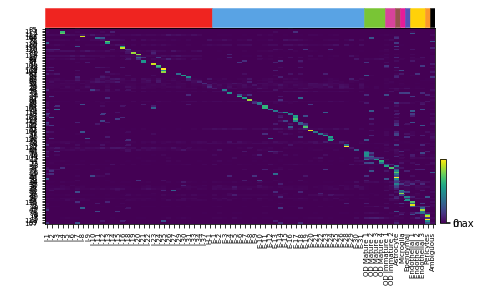

In [52]:
# Plot heatmap
from mpl_toolkits.axes_grid1 import make_axes_locatable
from collections import Counter
heat_map(dots_in_cells,[d[ctname_dict[x]] for x in dots_in_cells.columns.values], cluster_colors=color_clusters, sort = cluster_sort, save=True, name='Fig4c', fontsz=7, figsz=(7,4))